In [1]:
import torch; torch.manual_seed(0)
import torch.nn as nn
import torch.nn.functional as F
import torch.utils
import torch.distributions
import torchvision
import numpy as np
import pandas as pd
import torchvision.models as models 
from torchvision import transforms, utils
from torch.utils.data.sampler import SubsetRandomSampler
import torch.optim as optim
import matplotlib.pyplot as plt
import latent_plot as lp
from torch.autograd import Variable
from torch.optim import lr_scheduler
import seaborn as sns
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
import copy
#from model import VAE

import matplotlib.pyplot as plt; plt.rcParams['figure.dpi'] = 200
from data_loader import *
from model import convVAE
from sklearn.manifold import TSNE

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
csv_path = '/home/vip/sayan-mandal/datasets/ohts/progress_subset.csv'
img_path = '/home/vip/sayan-mandal/datasets/ohts/cropped_256'

ResizeParam = 128
batch_size = 72
FD = ProgressionDataLoader(csv_path, img_path,transform=transforms.Compose([transforms.Resize(ResizeParam), transforms.ToTensor()]))
data_loader = torch.utils.data.DataLoader(FD, batch_size = batch_size)

In [4]:
#vae model structure
nl = 2048
model = convVAE((3,128,128),nl).cuda()
model.load_state_dict(torch.load('/home/vip/sayan-mandal/vae-convmodels/dfcvae_inp128_nl'+str(nl)+'_a1b1.torch'))
print(model)

convVAE(
  (encoder): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.01)
    (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.01)
    (6): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.01)
    (9): Conv2d(64, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.01)
    (12): Flatten(start_dim=1, end_dim=-1)
  )
  (fc1): Sequential(
    (0): Linear(in_features=16384, out_features=4096, bias=True)
    (1): BatchNo

In [5]:
def interpolate(vaemodel, databatch, series):
    tfrac = (series - series.min())/(series.max() - series.min())
    print(tfrac)
    vaemodel.eval()
    y, _, _ = vaemodel.encode(Variable(databatch).cuda())
    ybatch = torch.stack([y[0] + (y[y.shape[0]-1]-y[0])*t for t in tfrac.numpy()])
    #Plot the images
    images = vaemodel.decode(ybatch)
    images = images.detach().cpu().numpy()
    return images

In [6]:
#Utility functions to un-normalize and display an image
def imshow(img):
    #img = img / 2 + 0.5  
    plt.imshow(np.transpose(img, (1, 2, 0))) 

#Define the image classes
classes = ['normal','glaucoma','suspect']

#Obtain one batch of training images
dataiter = iter(data_loader)
data, labels, time, idxs = dataiter.next()
data1 = data[idxs == 7]
labels1 = labels[idxs == 7]
time1 = time[idxs == 7]


In [7]:
data1 = data1[1:-1]
labels1 = labels1[1:-1]
time1 = time1[1:-1]
imgs = interpolate(model,data1,time1)

tensor([0.0000, 0.1130, 0.1213, 0.2243, 0.2300, 0.3346, 0.4461, 0.5600, 0.6697,
        0.7803, 0.8891, 1.0000], dtype=torch.float64)


In [8]:
model.eval()
images,_,_ = model(Variable(data1).cuda())
images = images.detach().cpu().numpy() # convert images to numpy for display

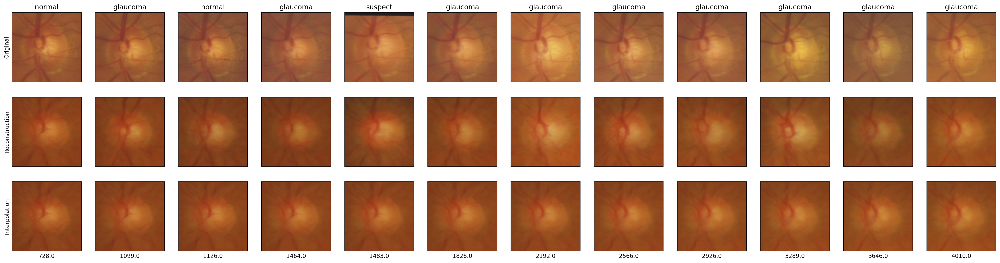

In [17]:
#Plot the images
fig = plt.figure(figsize=(24*1.3, 6*1.3))
# display 20 images

for idx in range(data1.shape[0]):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(data1[idx])
    ax.set_title(classes[labels1[idx]])
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Original')
for idx in range(data1.shape[0],int(data1.shape[0]*2) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(images[idx%data1.shape[0]])
    #ax.set_title(classes[labels1[idx]]+" | "+str(time1[idx].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Reconstruction')
for idx in range(int(data1.shape[0]*2),int(data1.shape[0]*3) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(imgs[idx%data1.shape[0]])
    ax.set_xlabel(str(time1[idx%data1.shape[0]].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Interpolation')



In [19]:
data, labels, time, idxs = dataiter.next()
data, labels, time, idxs = dataiter.next()
data, labels, time, idxs = dataiter.next()
idxs

tensor([ 8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,
         9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11,
        11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 13,
        13, 13, 13, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14])

In [28]:
data1 = data[idxs == 29]
labels1 = labels[idxs == 29]
time1 = time[idxs == 29]
data1 = torch.cat((data1[1:8],data1[10:]))
time1 = torch.cat((time1[1:8],time1[10:]))
labels1 = torch.cat((labels1[1:8],labels1[10:]))

imgs = interpolate(model,data1,time1)
model.eval()
images,_,_ = model(Variable(data1).cuda())
images = images.detach().cpu().numpy() # convert images to numpy for display

tensor([0.0000, 0.1006, 0.1124, 0.2320, 0.2375, 0.3174, 0.4188, 0.7049, 0.7966,
        0.8978, 1.0000], dtype=torch.float64)


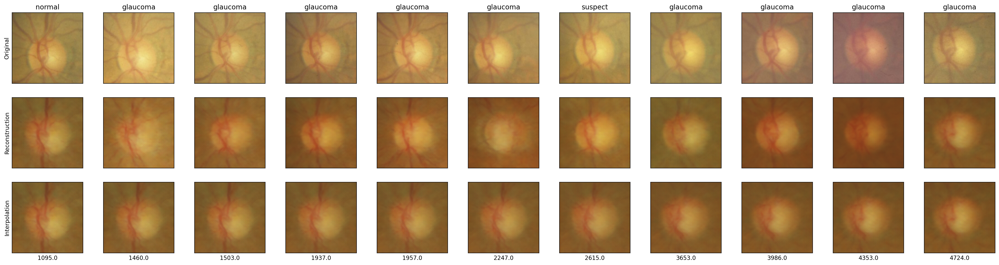

In [29]:
#Plot the images
fig = plt.figure(figsize=(24*1.3, 6*1.3))
# display 20 images

for idx in range(data1.shape[0]):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(data1[idx])
    ax.set_title(classes[labels1[idx]])
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Original')
for idx in range(data1.shape[0],int(data1.shape[0]*2) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(images[idx%data1.shape[0]])
    #ax.set_title(classes[labels1[idx]]+" | "+str(time1[idx].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Reconstruction')
for idx in range(int(data1.shape[0]*2),int(data1.shape[0]*3) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(imgs[idx%data1.shape[0]])
    ax.set_xlabel(str(time1[idx%data1.shape[0]].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Interpolation')



In [30]:
data, labels, time, idxs = dataiter.next()
idxs

tensor([30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 31, 31, 31, 31, 31, 31, 31, 32,
        32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 33, 33, 33, 33,
        33, 33, 33, 33, 33, 33, 33, 33, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34,
        34, 34, 35, 35, 35, 35, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36])

In [31]:
data1 = data[idxs == 30]
labels1 = labels[idxs == 30]
time1 = time[idxs == 30]

imgs = interpolate(model,data1,time1)
model.eval()
images,_,_ = model(Variable(data1).cuda())
images = images.detach().cpu().numpy() # convert images to numpy for display


tensor([0.0000, 0.0981, 0.2891, 0.3984, 0.4582, 0.5078, 0.6059, 0.7381, 0.7982,
        1.0000], dtype=torch.float64)


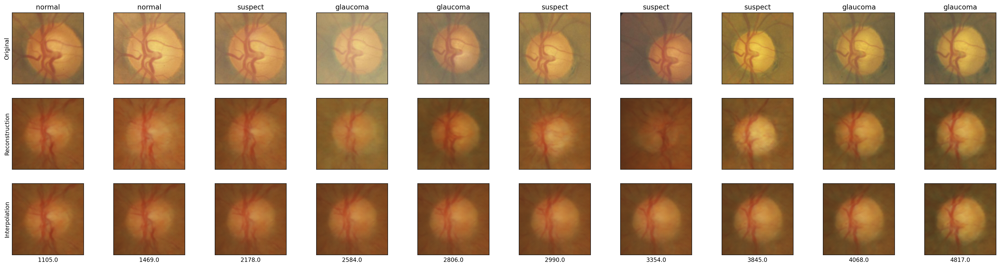

In [32]:
#Plot the images
fig = plt.figure(figsize=(24*1.3, 6*1.3))
# display 20 images

for idx in range(data1.shape[0]):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(data1[idx])
    ax.set_title(classes[labels1[idx]])
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Original')
for idx in range(data1.shape[0],int(data1.shape[0]*2) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(images[idx%data1.shape[0]])
    #ax.set_title(classes[labels1[idx]]+" | "+str(time1[idx].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Reconstruction')
for idx in range(int(data1.shape[0]*2),int(data1.shape[0]*3) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(imgs[idx%data1.shape[0]])
    ax.set_xlabel(str(time1[idx%data1.shape[0]].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Interpolation')



In [33]:
data, labels, time, idxs = dataiter.next()
data, labels, time, idxs = dataiter.next()

tensor([37, 37, 37, 37, 37, 37, 37, 37, 37, 37, 37, 38, 38, 38, 38, 38, 38, 38,
        38, 38, 38, 38, 38, 38, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39,
        40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 41, 41, 41, 41, 41,
        41, 41, 41, 41, 41, 41, 41, 41, 41, 42, 42, 42, 42, 42, 42, 42, 42, 42])

In [35]:
data1 = data[idxs == 45]
labels1 = labels[idxs == 45]
time1 = time[idxs == 45]
data1 = torch.cat((data1[:4],data1[5:13],data1[-3:]))
time1 = torch.cat((time1[:4],time1[5:13],time1[-3:]))
labels1 = torch.cat((labels1[:4],labels1[5:13],labels1[-3:]))

imgs = interpolate(model,data1,time1)
model.eval()
images,_,_ = model(Variable(data1).cuda())
images = images.detach().cpu().numpy() # convert images to numpy for display


tensor([0.0000, 0.0833, 0.1651, 0.2486, 0.4092, 0.4172, 0.5067, 0.5954, 0.6028,
        0.6814, 0.7218, 0.7713, 0.8612, 0.9032, 1.0000], dtype=torch.float64)


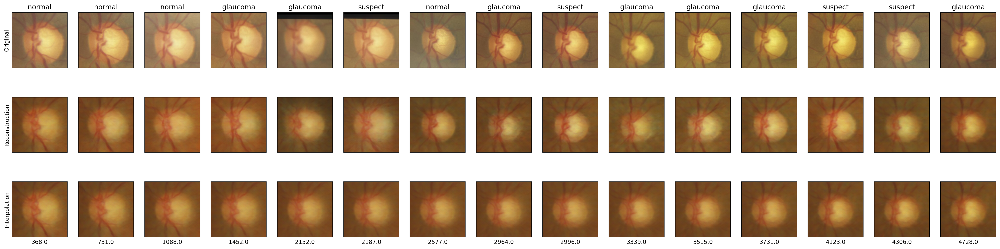

In [36]:
#Plot the images
fig = plt.figure(figsize=(24*1.3, 6*1.3))
# display 20 images

for idx in range(data1.shape[0]):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(data1[idx])
    ax.set_title(classes[labels1[idx]])
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Original')
for idx in range(data1.shape[0],int(data1.shape[0]*2) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(images[idx%data1.shape[0]])
    #ax.set_title(classes[labels1[idx]]+" | "+str(time1[idx].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Reconstruction')
for idx in range(int(data1.shape[0]*2),int(data1.shape[0]*3) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(imgs[idx%data1.shape[0]])
    ax.set_xlabel(str(time1[idx%data1.shape[0]].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Interpolation')



In [37]:
data, labels, time, idxs = dataiter.next()

data, labels, time, idxs = dataiter.next()
data, labels, time, idxs = dataiter.next()
idxs

tensor([54, 54, 54, 54, 54, 54, 55, 55, 55, 55, 55, 55, 55, 55, 55, 55, 55, 55,
        55, 55, 56, 56, 56, 56, 56, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57,
        57, 58, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 60, 60, 60,
        60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 61, 61, 61, 61, 61, 61, 61, 61])

In [39]:
data1 = data[idxs == 69]
labels1 = labels[idxs == 69]
time1 = time[idxs == 69]
data1 = data1[:11]
time1 = time1[:11]
labels1 = labels1[:11]

imgs = interpolate(model,data1,time1)
model.eval()
images,_,_ = model(Variable(data1).cuda())
images = images.detach().cpu().numpy() # convert images to numpy for display


tensor([0.0000, 0.0924, 0.2013, 0.3142, 0.3959, 0.5241, 0.5953, 0.6266, 0.7484,
        0.9278, 1.0000], dtype=torch.float64)


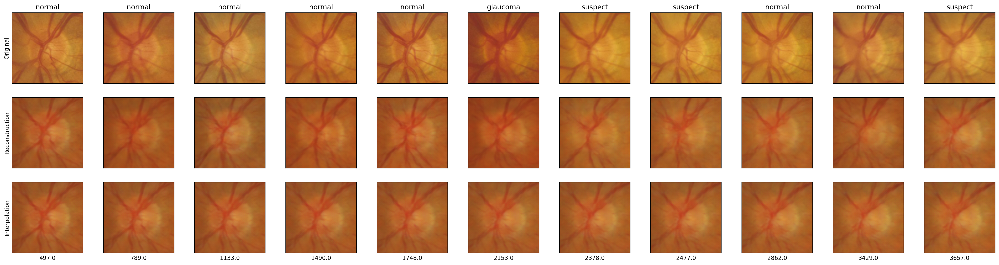

In [40]:
#Plot the images
fig = plt.figure(figsize=(24*1.3, 6*1.3))
# display 20 images

for idx in range(data1.shape[0]):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(data1[idx])
    ax.set_title(classes[labels1[idx]])
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Original')
for idx in range(data1.shape[0],int(data1.shape[0]*2) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(images[idx%data1.shape[0]])
    #ax.set_title(classes[labels1[idx]]+" | "+str(time1[idx].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Reconstruction')
for idx in range(int(data1.shape[0]*2),int(data1.shape[0]*3) ):
    ax = fig.add_subplot(3,data1.shape[0], idx+1, xticks=[], yticks=[])
    imshow(imgs[idx%data1.shape[0]])
    ax.set_xlabel(str(time1[idx%data1.shape[0]].item()))
    if idx%data1.shape[0] == 0:
        ax.set_ylabel('Interpolation')

